In [1]:
import os

import numpy as np
import matplotlib.pyplot as plt
import librosa
import librosa.display
from IPython.display import Audio
import torch
import soundfile as sf

from model.Network import UNet, encoder, decoder
from CustomDataset.Data import dataloader


Load audio

In [2]:
# song_path = "./"
audio_array, sr = librosa.load(
    "./song/input/Adele - Rolling in the Deep (Official Music Video).wav"
)


In [3]:
Audio(audio_array, rate=sr)


Spectrogram

In [133]:
audio_stft = librosa.stft(audio_array, n_fft=1024, hop_length=768)


In [134]:
audio_stft.shape


(513, 6716)

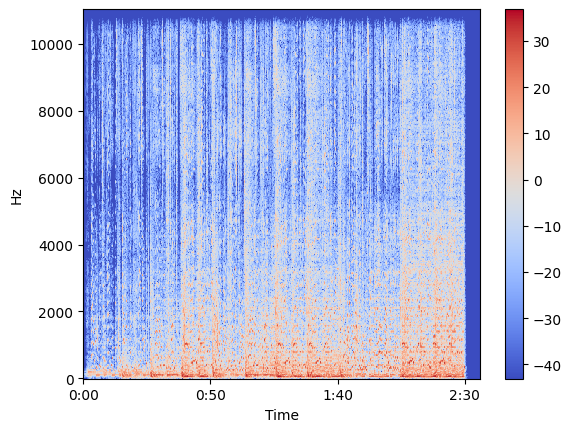

In [135]:
audio_stft_db = librosa.amplitude_to_db(np.abs(audio_stft))
librosa.display.specshow(audio_stft_db, sr=sr, x_axis="time", y_axis="hz")
plt.colorbar()
plt.show()


invers_stft

In [136]:
audio_inv_stft = librosa.istft(
    (
        audio_stft[
            :511,
        ]
    ),
    n_fft=1024,
    hop_length=768,
)


In [137]:
Audio(audio_inv_stft, rate=sr)


Load model

In [138]:
# device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device = torch.device("cpu")


In [139]:
stem = "vocal"
# stem = 'instrumental'
# stem = 'bass'
# stem = 'drum'


In [140]:
model = torch.load(f"./model/save_model/{stem}_best_model.pt", map_location=device)


In [141]:
total_frame = audio_stft.shape[1] // 127 + 1
done_frame = 0
model.eval()
for i in range(0, audio_stft.shape[1], 127):
    mixture = np.abs(audio_stft[:511, i : i + 127])
    col_num = mixture.shape[1]
    if col_num != 127:
        mixture = np.concatenate(
            (mixture, np.zeros(shape=(511, 127 - col_num))), axis=1
        )

    mixture = torch.from_numpy(mixture[np.newaxis, np.newaxis, :, :]).to(device)
    input = dataloader(mixture.to(torch.float32), batch_size=1)
    with torch.no_grad():
        for x in input:
            # print(x.shape)
            y = model(x)
            if i == 0:
                output = y[0][0]
            else:
                if col_num == 127:
                    output = torch.cat([output, y[0][0]], dim=1)
                else:
                    output = torch.cat([output, y[0][0][:, :col_num]], dim=1)
    done_frame += 1
    print(f"{done_frame}/{total_frame}")


1/53
2/53
3/53
4/53
5/53
6/53
7/53
8/53
9/53
10/53
11/53
12/53
13/53
14/53
15/53
16/53
17/53
18/53
19/53
20/53
21/53
22/53
23/53
24/53
25/53
26/53
27/53
28/53
29/53
30/53
31/53
32/53
33/53
34/53
35/53
36/53
37/53
38/53
39/53
40/53
41/53
42/53
43/53
44/53
45/53
46/53
47/53
48/53
49/53
50/53
51/53
52/53
53/53


In [142]:
output = (output.to(torch.device("cpu"))).numpy()


In [143]:
print(audio_stft[:511, :].shape)
print(output.shape)


(511, 6716)
(511, 6716)


In [144]:
output = np.multiply(audio_stft[:511, :], output)


In [145]:
audio_output = librosa.istft(output, n_fft=1024, hop_length=768)


In [146]:
Audio(audio_output, rate=sr)


save audio

In [155]:
sf.write("./song/output/song_stem_name.wav", audio_output, sr)
